## COMP5721M: Programming for Data Science 

## Coursework 3: Data Analysis Project


# _Analysis of COVID and Vaccination data_



* Deepak Bisht, mm22db@leeds.ac.uk
* Nilesh Kumar, mm22nk@leeds.ac.uk
* Rahul Scaria, mm22r2s@leeds.ac.uk
* Sohail Suleman Zaveri, mm22ssz@leeds.ac.uk

# Project Plan

## The Data

Source of our data is `WHO - World Health Organization` data archive, i.e. https://covid19.who.int/data. The data utilized for investigation is taken from WHO datasets, which is dependent upon variations in view of consistent check and change. This data is continuously updated.

For this project, we are using three different datasets from the same source, i.e. WHO.
* `covid_data.csv`
* `owid_covid_data.csv`
* `vaccination_data.csv`


The exactness and unwavering quality of the data is approved by the efficient methodology of information assortment, arrangement, coding and examination, and continuous validation activities of WHO. The data will be additionally refined, improved and adjusted to new advancements in the nations' reactions to Coronavirus.

The detailed description of each dataset in given below:

**`covid_data.csv`**


It contains daily cases and deaths, date reported for every country and also the cumulative sum of cases and deaths. It also contains WHO regional office name for each region.

| Field name | Type | Description |
| :--- | :--- | :--- |
| Date_reported | Date | Date when case is reported. |
| Country_code | String | Date when case is reported. |
| Country | String | Name of the country. |
| WHO_region | String | WHO regional offices. |
| New_cases | Integer | Cases reported for a particular day. |
| Cumulative_cases | Integer | Cumulative cases till that day. |
| New_deaths | Integer | Deaths reported for a particular day |
| Cumulative_deaths | Integer | Cumulative deaths till that day. |




**`owid_covid_data.csv`**

It contains daily data of various parameters related to COVID-19 like cases, deaths and vaccinations. From the dataset the following are the columns of interest.

| Field name | Type | Description |
| :--- | :--- | :--- |
| location | string | Name of the country. |
| date | Date | Date of vaccination. |
| people_fully_vaccinated | Integer | Number of people vaccinated for a particular day.|






**`vaccination_data.csv`**

It contains data related to COVID-19 vaccinations for each country such as date of first adoption, names of vaccines administered, total vaccine doses administered etc.


| Field name | Type | Description |
| :--- | :--- | :--- |
| COUNTRY | Date | Name of the country. |
| ISO3 | String | Country code. |
| WHO_REGION | String | WHO regional offices. |
| DATE_UPDATED | Date | Date of update. |
| TOTAL_VACCINATIONS | Integer | Cumulative total vaccine doses. |
| PERSONS_VACCINATED_1PLUS_DOSE	 | Decimal | Cumulative number of persons vaccinated with at least one dose |
| TOTAL_VACCINATIONS_PER100 | Integer | Cumulative total vaccine doses administered per 100 population. |
| PERSONS_VACCINATED_1PLUS_DOSE_PER100 | Decimal | Cumulative persons vaccinated with at least one dose per 100 population. |
| PERSONS_FULLY_VACCINATED | Integer | Cumulative number of persons fully vaccinated. |
| PERSONS_FULLY_VACCINATED_PER100 | Decimal | Cumulative number of persons fully vaccinated per 100 population. |
| VACCINES_USED | String | Name of vaccine. |
| FIRST_VACCINE_DATE | Date | Date of first vaccinations. |
| NUMBER_VACCINES_TYPES_USED | Integer | Number of vaccine types used per country. |
| PERSONS_BOOSTER_ADD_DOSE	 | Integer | Number of people who received booster or additional dose. |
| PERSONS_BOOSTER_ADD_DOSE_PER100 | Decimal | Number of people who received booster or additional dose per 100 population. |

  



## Project Aim and Objectives



COVID-19 is the first pandemic so enormous in this advanced modern technological era that no one could anticipate its catastrophic effects. This occurred on a scale so huge that it shook the entire world and yet joined masses together. The impact of Coronavirus was enormous to the point that such countless individuals' lives have been affected which inspired us to plunge into the facts and numbers.


Looking at the number of cases and deaths for every country, we aim to figure out the worst affected nations because of COVID-19. We further investigate how vaccination has affected the death rate for these nations. Likewise, we also look at the popularity of various vaccines and how quick nations began vaccinating. Finally, we try to look for the most successful nations in terms of vaccination rates.

We intend to use the power of visualisations to gain deeper insights about the trends observed for various parameters related to COVID-19. We use line plots to study the variations in cases, deaths and vaccinations, bar plots to analyse parameters like popularity of different vaccines and finally a world map to depict fully vaccinated population percentage for all the countries.





### Specific Objectives


* __Objective 1:__ _compare monthly rate of cases and deaths for worst affected countries_
* __Objective 2:__ _examine vaccination rate for worst affected countries_
* __Objective 3:__ _find countries with maximum vaccination rates_
* __Objective 4:__ _analyse most popular vaccines and their adoption by countries_



## System Design

### Architecture

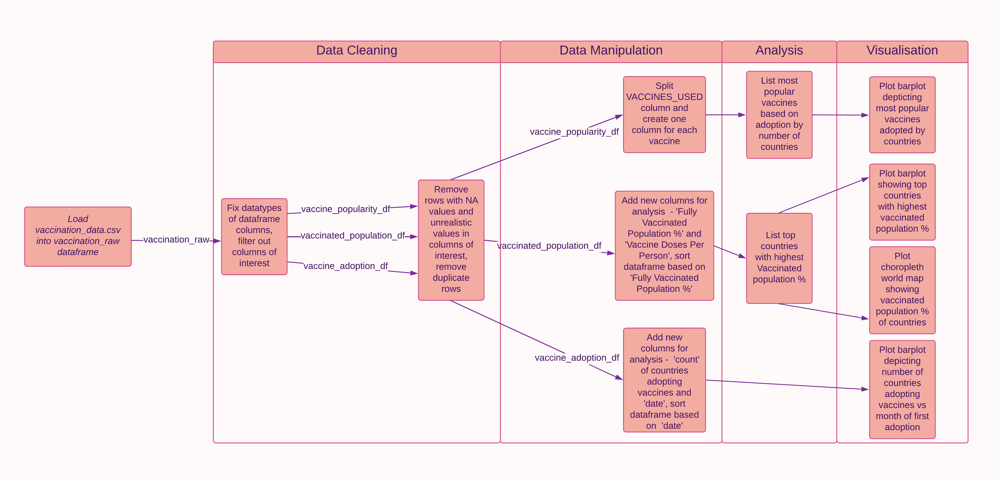

The architecture of this data analysis notebook involves a streamlined sequence of stages in which the data is cleaned, manipulated, analysed, prepared for visualisations and finally visualised. We use three datasets for analysis, and each dataset is imported into pandas dataframes. The lifecycle of one of the datasets is depicted in the pipeline above. Each dataframe is checked for datatypes of its columns, rows with NA values, duplicate rows and unrealistic values. As can be seen from the pipeline, ***vaccination_raw*** dataframe is used for three kinds of analysis, so it is divided into three different dataframes with appropriate columns. New columns of interest are added to these dataframes, and the dataframes are sorted based on the requirement of their respective analysis. Finally, these dataframes are prepared for visualisations, and appropriate visualisations are presented.

### Processing Modules and Algorithms

* We are using gdown library to download geoJson file from google drive and read it into a Json object. We also add a field called ***id*** in each object in the ***features*** list in the json object to create a one-to-one mapping of these objects with countries. This file is used in creating the choropleth world map.
* The dataframe `vaccination_raw` is divided into 3 different dataframes `vaccine_popularity_df`, `vaccinated_population_df` and `vaccine_adoption_df` by filtering out the appropriate columns for each dataframe.
* All the time series data has been aggregated into month-wise data using suitable grouping techniques.
* The rows with unrealistic values in the column `PERSONS_FULLY_VACCINATED_PER100` have been removed from `vaccinated_population_df`, as values in this column cannot be greater than 100.

# Program Code 


In [1]:
import pandas as pd
from datetime import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings
import plotly.express as px
import json
import gdown
warnings.filterwarnings("ignore")
%matplotlib inline

#### Function for reading the GeoJson file

Defining a function that reads a geoJson file and returns a json object. A geoJson file contains information which can be used to create a choropleth world map. This file was created using this tool: https://geojson-maps.ash.ms/. The function also creates a field called ***id*** in each object of the ***features*** list. This field helps in creating a one-to-one mapping between the ***feature*** objects in json object and rows in our dataframe.

In [2]:
geojson_url = 'https://drive.google.com/uc?id=1Q1zALnXG658OovqxjyA_7CnRoKM688YE'
def read_geojson(url = geojson_url):
    output = "geoJson.json"
    gdown.download(url, output, quiet = True)
    world_json = json.load(open(output, 'r', encoding = 'utf-8'))
    for feature in world_json['features']:
        feature['id'] = feature['properties']['iso_a3']
    return world_json

#### Importing the dataframes 
Importing the dataframe to a variable named **daily_covid** which dataframe contains daily data of covid cases and deaths for each country.

**covid_data** contains day-wise data of various parameters associated with covid like tests, cases, vaccinations etc. for each country.

**vaccination_raw** contains data about the vaccinated people for each country.

In [3]:
daily_covid = pd.read_csv("https://covid19.who.int/WHO-COVID-19-global-data.csv")
covid_data = pd.read_csv("https://raw.githubusercontent.com/owid/covid-19-data"+
                         "/master/public/data/owid-covid-data.csv")
vaccination_raw = pd.read_csv("https://covid19.who.int/who-data/vaccination-data.csv")


## Cleaning the datafarames
### For `daily_covid` dataframe

#### Checking for duplicates
As this data is updated daily for every country, it should not have duplicate **Date** for a particular **Country**. So, we will count the number of duplicates.

In [4]:
sum(daily_covid.duplicated(subset=["Country", "Date_reported"]))

0

#### Checking for completeness of data
Checking for values in **Country** column to see if data is available for every country and date. 

In [5]:
daily_covid["Country"].value_counts()

Afghanistan        1065
Paraguay           1065
Nigeria            1065
Niue               1065
North Macedonia    1065
                   ... 
Grenada            1065
Guadeloupe         1065
Guam               1065
Guatemala          1065
Zimbabwe           1065
Name: Country, Length: 237, dtype: int64

Since all the Countries have **1049** rows, we can say the data is complete and uniform. 

#### Checking for null values 
Now, we will check for missing values in the dataframe for every column.

In [6]:
daily_covid.isna().sum()

Date_reported           0
Country_code         1065
Country                 0
WHO_region              0
New_cases               0
Cumulative_cases        0
New_deaths              0
Cumulative_deaths       0
dtype: int64

The only column that has null/missing values is Country_code. So, now checking the NaN values for **Country_code** column.

In [7]:
daily_covid[daily_covid["Country_code"].isna()].head()

,Date_reported,Country_code,Country,WHO_region,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
152295,2020-01-03,NaN,Namibia,AFRO,0,0,0,0
152296,2020-01-04,NaN,Namibia,AFRO,0,0,0,0
152297,2020-01-05,NaN,Namibia,AFRO,0,0,0,0
152298,2020-01-06,NaN,Namibia,AFRO,0,0,0,0
152299,2020-01-07,NaN,Namibia,AFRO,0,0,0,0


We have **NaN** in **Country_code** column. For ***Namibia***, the country code is _NA_ so we will insert this to the dataframe.

In [8]:
daily_covid.fillna(value = "NA", inplace = True)

#### Checking for inconsistent format of data
Now, we will check the data type of each column.

In [9]:
daily_covid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 252405 entries, 0 to 252404
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   Date_reported      252405 non-null  object
 1   Country_code       252405 non-null  object
 2   Country            252405 non-null  object
 3   WHO_region         252405 non-null  object
 4   New_cases          252405 non-null  int64 
 5   Cumulative_cases   252405 non-null  int64 
 6   New_deaths         252405 non-null  int64 
 7   Cumulative_deaths  252405 non-null  int64 
dtypes: int64(4), object(4)
memory usage: 15.4+ MB


The data type of **Date_reported** should be datetime instead of object. So, we will convert it to datetime.

In [10]:
daily_covid["Date_reported"] = pd.to_datetime(daily_covid["Date_reported"])

The data is clean and now it's time to aggreagate it for further analysis.



### For `covid_data` dataframe

**Filtering the dataframe _covid_data_ and checking for missing values**

We are only considering the cumulative of people who are fully vaccinated, from the dataset. Filtering the dataframe and keeping the columns that are required for this analysis. Also removing the rows that have null values in these columns of interest.

In [11]:
covid_data= covid_data[['location','date','people_fully_vaccinated']]
covid_data=covid_data.dropna()

#### Converting the datatype of the column 'date' from object to datetime


In [12]:
covid_data['date'] = pd.to_datetime(covid_data['date'])

#### **Checking if there are any duplicate rows having the same value for the column 'date' for each country**

The column 'location' represents a country. Checking whether dates are repeating for a country.

In [13]:
sum(covid_data.duplicated(subset=['location','date']))

0

### For `vaccination_raw` dataframe

The dataframe contains a row for each country, and each row contains information on the vaccines used by the respective country. The columns of interest in this dataframe are:
* TOTAL_VACCINATIONS
* TOTAL_VACCINATIONS_PER100
* PERSONS_FULLY VACCINATED
* PERSONS_FULLY_VACCINATED_PER100
* FIRST_VACCINATION_DATE
* VACCINES_USED

#### Changing the datatype of DATE_UPDATED and FIRST_VACCINE_DATE column to datetime

In [14]:
vaccination_raw['DATE_UPDATED'] = pd.to_datetime(vaccination_raw['DATE_UPDATED'], 
                                                 dayfirst=True)
vaccination_raw['FIRST_VACCINE_DATE'] = pd.to_datetime(vaccination_raw['FIRST_VACCINE_DATE'], 
                                                       dayfirst = True)
vaccination_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 229 entries, 0 to 228
Data columns (total 16 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   COUNTRY                               229 non-null    object        
 1   ISO3                                  229 non-null    object        
 2   WHO_REGION                            229 non-null    object        
 3   DATA_SOURCE                           229 non-null    object        
 4   DATE_UPDATED                          229 non-null    datetime64[ns]
 5   TOTAL_VACCINATIONS                    228 non-null    float64       
 6   PERSONS_VACCINATED_1PLUS_DOSE         228 non-null    float64       
 7   TOTAL_VACCINATIONS_PER100             227 non-null    float64       
 8   PERSONS_VACCINATED_1PLUS_DOSE_PER100  228 non-null    float64       
 9   PERSONS_FULLY_VACCINATED              228 non-null    float64       
 10  PE

#### Creating dataframes for:
1. Finding countries with maximum vaccinated population percentage.
2. Finding monthly vaccine adoption percentage.
3. Finding popularity of vaccine based on number of countries using it.

In [15]:
vaccinated_population_df = vaccination_raw[['COUNTRY', 'ISO3', 'TOTAL_VACCINATIONS', 
                                            'TOTAL_VACCINATIONS_PER100',  
                                            'PERSONS_FULLY_VACCINATED', 
                                            'PERSONS_FULLY_VACCINATED_PER100']].copy()
vaccine_adoption_df = vaccination_raw[['COUNTRY', 'FIRST_VACCINE_DATE']].copy()
vaccine_popularity_df = vaccination_raw[['COUNTRY', 'VACCINES_USED']].copy()

#### Checking for NaN values 

Checking missing values and removing rows with missing data in vaccinated_population_df.

In [16]:
vaccinated_population_df.drop(index = vaccinated_population_df[pd.isna(
                            vaccinated_population_df.TOTAL_VACCINATIONS)].index, 
                              inplace = True)
vaccinated_population_df.drop(index = vaccinated_population_df[pd.isna(
                            vaccinated_population_df.PERSONS_FULLY_VACCINATED)].index, 
                              inplace = True)
pd.isna(vaccinated_population_df).sum()

COUNTRY                            0
ISO3                               0
TOTAL_VACCINATIONS                 0
TOTAL_VACCINATIONS_PER100          1
PERSONS_FULLY_VACCINATED           0
PERSONS_FULLY_VACCINATED_PER100    0
dtype: int64

NaN value found in TOTAL_VACCINATIONS_PER100, but it can be calculated from rest of the columns.
As it can be seen from the output of the above cell, there is a row which contains a null value for the column *TOTAL_VACCINATIONS_PER100* and not in the columns *TOTAL_VACCINATIONS*, *PERSONS_FULLY_VACCINATED*, *PERSONS_FULLY_VACCINATED_PER100*. If we know the value of population of this country, we can easily find the value for the column *TOTAL_VACCINATIONS_PER100*, since we already have the value of *TOTAL_VACCINATIONS* for that country.

#### Making a new temperory column *POPULATION* and filling NaN values
In the following cell, a new column named *POPULATION* is created using the existing columns *PERSONS_FULLY_VACCINATED* and *PERSONS_FULLY_VACCINATED_PER100*. This column is then used to fill the missing value in the *TOTAL_VACCINATIONS_PER100* column.

In [17]:
population = vaccinated_population_df[
                "PERSONS_FULLY_VACCINATED"] * 100 / vaccinated_population_df["PERSONS_FULLY_VACCINATED_PER100"]
vaccinated_population_df['POPULATION'] = population
total_doses_per_person = vaccinated_population_df['TOTAL_VACCINATIONS'] * 100 / vaccinated_population_df['POPULATION']
vaccinated_population_df.loc[vaccinated_population_df["TOTAL_VACCINATIONS_PER100"].isna(), 
                             'TOTAL_VACCINATIONS_PER100'] = total_doses_per_person * 100


#### Looking for unrealistic values

In [18]:
vaccinated_population_df.max(numeric_only = True)

TOTAL_VACCINATIONS                 3.464049e+09
TOTAL_VACCINATIONS_PER100          1.833625e+04
PERSONS_FULLY_VACCINATED           1.277348e+09
PERSONS_FULLY_VACCINATED_PER100    1.850880e+02
POPULATION                         1.471294e+09
dtype: float64

In the column *PERSONS_FULLY_VACCINATED_PER100*, it is observed that the maximum value greater than 100 which is an unrealistic value.

#### Removing rows with unrealistic values in columns of interest

In the following cell, we remove the rows which contain value > 100 in the column *PERSONS_FULLY_VACCINATED_PER100*.

In [19]:
vaccinated_population_df = vaccinated_population_df[vaccinated_population_df.
                                                    PERSONS_FULLY_VACCINATED_PER100 <= 100]

#### Checking for NaN values and removing rows with missing data in vaccine_adoption_df

Checking for null value in `FIRST_VACCINE_DATE` and removing it.

In [20]:
vaccine_adoption_df.drop(index = vaccine_adoption_df[pd.isna(vaccine_adoption_df.FIRST_VACCINE_DATE)].index, 
                         inplace = True)
pd.isna(vaccine_adoption_df).sum()

COUNTRY               0
FIRST_VACCINE_DATE    0
dtype: int64

#### Removing duplicate rows in `vaccine_adoption_df`
Checking for duplicate values in `FIRST_VACCINE_DATE` and `COUNTRY` and removing it.

In [21]:
vaccine_adoption_df.drop_duplicates(subset=["FIRST_VACCINE_DATE", "COUNTRY"],keep=False)
sum(vaccine_adoption_df.duplicated(subset=["FIRST_VACCINE_DATE", "COUNTRY"]))

0

#### Checking for null values in vaccine_popularity_df

The two variables of interest in this analysis are **COUNTRY** and **VACCINES_USED**. Checking if there are any NaN values in these columns.

In [22]:
vaccine_popularity_df[['COUNTRY','VACCINES_USED']].isna().sum()

COUNTRY          0
VACCINES_USED    4
dtype: int64

In [23]:
vaccine_popularity_df[vaccine_popularity_df['VACCINES_USED'].isna()]

,COUNTRY,VACCINES_USED
25,Bonaire,NaN
64,Eritrea,NaN
173,Saba,NaN
187,Sint Eustatius,NaN


These are the 4 countries that have NaN values for VACCINES_USED.

#### Removing the rows (countries) having NaN values for VACCINES_USED

In [24]:
vaccine_popularity_df=vaccine_popularity_df[~(vaccine_popularity_df['VACCINES_USED'].isna())]

#### Checking if there are any dupliacte values in the column COUNTRY
For the column **COUNTRY**, checking whether there any repetitions.

In [25]:
vaccine_popularity_df['COUNTRY'].duplicated().any()

False

Since there are no duplicate countries, we can now continue with aggregating and manipulating the dataframe for the purpose of our analysis of comparing the popularity of different vaccines.

## Manipulating and Aggregating the datafarames
### For `daily_covid` dataframe

#### Adding a new column *month_year*

To see monthly variation of cases and deaths, we will create a new column which contains month and year for that particular row. So, for date 2020-01-03 it will be Jan 2020. Doing this will help us easily aggregate data based on month.

In [26]:
daily_covid['month_year'] = daily_covid['Date_reported'].dt.strftime("%b %Y")

#### Finding most affected countries 

Based on total number of deaths from Jan 2020, we will find out the countries which were affected the most by COVID. First, we will group by **Country** and take the maximum value (last value for each country) of **Cumulative_deaths**. By sorting in descending order, we will get the countries with highest number of deaths due to COVID.

In [27]:
daily_covid.groupby(["Country"])["Cumulative_deaths"].agg(["max"]).sort_values(by="max", ascending = False).head()

,max
Country,
United States of America,1071245
Brazil,689801
India,530624
Russian Federation,392117
Mexico,330495


As we can clearly see that USA, Brazil and India were the top three countries which were worst-affected by COVID. USA has the most deaths (1.06 Million). Now for these countries, we will check the number of cases and deaths.

In [28]:
top_three_countries = ["United States of America" , "Brazil", "India"]
daily_covid[daily_covid["Country"].isin(top_three_countries)].groupby(["Country"])["Cumulative_deaths",
                                                                        "Cumulative_cases"].agg(["max"]).head()


,Cumulative_deaths,Cumulative_cases
,max,max
Country,,
Brazil,689801,35266159
India,530624,44672913
United States of America,1071245,97618392


#### Monthly trend of cases and deaths
To check the monthly trend of cases and deaths, we will create a dataframe which will use **New_cases** and **New_deaths** column from the original dataframe **covid_cases**. Firstly, grouping by country and month and then aggregating the data using sum will add all the values of **New_cases** and **New_deaths** for a particular country, for every month. So, we will get monthwise cases and deaths for USA, Brazil and India.

In [29]:
cases_deaths_countrywise = daily_covid[daily_covid["Country"].isin(top_three_countries)].groupby(
                            ["Country","month_year"], as_index=False, sort=False)["New_deaths","New_cases"].agg(
                            ["sum"]).unstack(level=0)
cases_deaths_countrywise.head()

New_deaths                                New_cases          \
                  sum                                      sum           
Country        Brazil India United States of America    Brazil   India   
month_year                                                               
Jan 2020            0     0                        0         0       5   
Feb 2020            0     0                        1         1       2   
Mar 2020          136    32                     3326      4255    1244   
Apr 2020         4881  1042                    57134     67630   31799   
May 2020        22861  4090                    44864    393280  149093   

                                     
                                     
Country    United States of America  
month_year                           
Jan 2020                          8  
Feb 2020                         61  
Mar 2020                     173074  
Apr 2020                     857163  
May 2020                     755116

#### Creating a function to plot cases and deaths
This function will plot monthly cases and deaths for a given argument (name of country). This is only for top three countries, but it can be changed anytime to plot trend for other countries also. This function creates a time series graph: total number of cases and deaths for each month. This function returns a dual axis graph in which one axis is for number of cases and one is for number of deaths.

In [30]:
def plot_countrywise(country):    
    sns.set_style("darkgrid")
    plt.figure(figsize=(16,4), dpi = 200) # Configuring figure size and graph-style.
    
    cases_graph=sns.lineplot(data=cases_deaths_countrywise["New_cases"]["sum"][country],
                             label='Cases', color = "green") # Lineplot for number of covid cases per month.
    plt.xlabel(" ") 
    plt.ylabel("Cases (Millions)")
    # Converting y-tick values to millions.
    ylabels_cases = ['{:,.1f}'.format(x) for x in cases_graph.get_yticks()/1000000] 
    cases_graph.set_yticklabels(ylabels_cases)
    plt.xticks(rotation=45) # Rotating xticks to 45 degrees.
    plt.title(f"Monthly trend of cases and deaths ({country})") 
    ax2 = plt.twinx() # Creating dual axis for the graph, one for cases and one for deaths.

    death_graph=sns.lineplot(data=cases_deaths_countrywise["New_deaths"]["sum"][country], 
                             color = "red", ax=ax2, label='Deaths') # Lineplot for number of deaths per month
    plt.ylabel("Deaths (Thousands)")
    # Converting y-tick values to thousands.
    ylabels_death = ['{:,.0f}'.format(x) for x in death_graph.get_yticks()/1000] 
    death_graph.set_yticklabels(ylabels_death)
    
    # Positioning the legend of covid cases graph to a specific position.
    sns.move_legend(cases_graph, loc=(0.001,0.90)) 


    plt.show()


### For `covid_data` dataframe

#### **Manipulating the dataframe to get the number of people fully vaccinated month-wise for the countries of interest**

Changing location name from **United States** to **United States of America**, for uniformity.

In [31]:
covid_data.loc[covid_data["location"] == "United States", "location"] = "United States of America"

In our analysis, we are plotting the vaccination rate (people fully vaccinated) across months. The data that we have now is daily data. Conversion from daily data to monthly data has to be done. This is done by adding new column Mon_Year and then using the groupby() function to group the data monthwise. Also sorting the dataframe based on the Month and Year.


In [32]:
covid_data['Mon_Year'] = covid_data['date'].dt.strftime('%b-%Y')
fully_vaccinated_countrywise = covid_data[covid_data["location"].isin(top_three_countries)].groupby(
                            ["location","Mon_Year"], as_index=False, sort=False)["people_fully_vaccinated"].agg(
                            ["max"]).unstack(level=0)
fully_vaccinated_countrywise = fully_vaccinated_countrywise.reset_index()
fully_vaccinated_countrywise.Mon_Year = pd.to_datetime(fully_vaccinated_countrywise.Mon_Year)
fully_vaccinated_countrywise = fully_vaccinated_countrywise.sort_values(by='Mon_Year')
fully_vaccinated_countrywise.Mon_Year = fully_vaccinated_countrywise.Mon_Year.dt.strftime("%b %Y")

#### Creating a function that will plot the monthly vaccination rate for countries
This function accepts three arguments, which are the dataframes for each country we are considering. The package seaborn has been used to plot the lineplots for each country. The lines for all countries are plotted in the same graph as seperate lines. The x axis is months and y axis is the number of people fully vaccinated in millions.

In [33]:
def plot_vaccination_rate(x,y,z):
    sns.set_style("darkgrid")
    # Configuring figure size.
    plt.figure(figsize=(16,6), dpi = 100)
    # Line plot for people fully vaccinated each month for 1st country
    ax= sns.lineplot(x=fully_vaccinated_countrywise.Mon_Year,y=fully_vaccinated_countrywise['max'][x])
    ax.set_yticklabels(['','0','200','400','600','800','1000'])
    # Line plot for people fully vaccinated each month for 2nd country
    ax1 = sns.lineplot(x=fully_vaccinated_countrywise.Mon_Year,y=fully_vaccinated_countrywise['max'][y],
                       color="red")
    # Line plot for people fully vaccinated each month for 3rd country
    ax2 = sns.lineplot(x=fully_vaccinated_countrywise.Mon_Year,y=fully_vaccinated_countrywise['max'][z],
                       color="green")
    plt.xlabel("")
    plt.ylabel("People fully vaccinated (Million)")
    # Rotating xticks by 45 degrees.
    plt.xticks(rotation=45)
    plt.legend(title='Countries', loc='right', labels=[x,y,z])
    plt.show()

### For `vaccination_raw ` dataframe


#### Adding new columns - Vaccine Doses Per Person and Fully Vaccinated Population %
In the following cell, we add new columns ***Vaccine Doses Per Person*** and ***Fully Vaccinated Population %***.

In [34]:
vaccinated_population_df['Vaccine Doses Per Person'] = vaccinated_population_df.TOTAL_VACCINATIONS_PER100 / 100
vaccinated_population_df['Fully Vaccinated Population %'] = vaccinated_population_df.PERSONS_FULLY_VACCINATED_PER100

#### Countries with highest percentage of vaccinated population
We explore which countries have vaccinated maximum percentage of its population using the columns created above. By sorting based on ***Fully Vaccinated Population %*** in descending order, we will get the countries with highest percentage of vaccinated population.

In [35]:
vaccinated_population_df = vaccinated_population_df.sort_values(by = 'Fully Vaccinated Population %', 
                                                                ascending = False)
target_variables = ['COUNTRY', 'Fully Vaccinated Population %']
most_affected_countries_df = vaccinated_population_df[vaccinated_population_df
                                                      .COUNTRY.isin(top_three_countries)][target_variables]
top_countries_df = vaccinated_population_df[target_variables].iloc[:5, :]
pd.concat([top_countries_df, most_affected_countries_df])


,COUNTRY,Fully Vaccinated Population %
217,United Arab Emirates,99.008
167,Qatar,98.895
166,Puerto Rico,96.678
39,Cayman Islands,92.056
178,Samoa,89.536
29,Brazil,79.181
95,India,68.896
219,United States of America,68.164


#### Data Preparation for plotting countries with the highest proportion of fully vaccinated population 
We create a function to prepare a dataframe that can be used to create barplot showing both ***Fully Vaccinated Population %*** and ***Vaccine Doses Per Person***.

In [36]:
def prepare_barplot_data(number_of_countries = 8, include_countries = []):
    req_columns = ['ISO3', 'COUNTRY', 'Fully Vaccinated Population %', 'Vaccine Doses Per Person']

    barplot_country_count = number_of_countries - len(include_countries)
    
    # Vaccination Df is already sorted, so taking the top rows
    barplot_df = vaccinated_population_df[req_columns][:barplot_country_count].copy() 
    desired_countries = vaccinated_population_df[vaccinated_population_df.COUNTRY.isin(include_countries)][req_columns]
    # Concatenating dataframes of countries with highest vaccinated population % and desired countries
    barplot_df = pd.concat([barplot_df, desired_countries])
    
    # Sorting again to accomodate the list of countries provided as argument to this function
    barplot_df = barplot_df.sort_values(by = ['Fully Vaccinated Population %'], ascending = False) 
    
    # Using melt to prepare the dataframe for barplot
    barplot_df = barplot_df.melt(id_vars = ['ISO3', 'COUNTRY'], var_name = 'Quantity')
    
    return barplot_df


#### Function for Scaling data to fit two plots in the same barplot
In the following cell, we define a function to scale data so that multiple plots can fit in the same plotting area. For example, one quantity may have a range four times the range of another quantity. In order to fit both these quantities in the same plotting area, the quantity with the higher range is scaled down by 4 so that it fits in the plotting area.

In [37]:
def scale_data_for_barplot(barplot_df, scale):
    # Defining mask to select rows where Quantity is 'Vaccine Doses Per Person'
    mask = (barplot_df['Quantity'] == 'Vaccine Doses Per Person')
    # Scaling down the values in 'value' column by the scale provided as argument to this function
    barplot_df.loc[mask, 'value'] = barplot_df.loc[mask, 'value']/scale
    return barplot_df

#### Function for plotting the barplot using seaborn
We define a function to create the barplot that shows countries with highest proportion of fully vaccinated people, along with total number of vaccine doses administered per person. We create appropriate axes, legend and labels in the plot.

In [38]:
def barplot_countries_highest_percentage(number_of_countries = 8, include_countries = []):
    
    sns.set_style("white")
    # Prepare the data for barplot
    barplot_df = prepare_barplot_data(number_of_countries, include_countries)
    
    # 4 is the range of Vaccine Doses per person and 100 is the range of Vaccinated Population Percentage
    total_vaccines_scale = 4/100 
    
    barplot_df = scale_data_for_barplot(barplot_df, scale = 4/100) 

    
    plt.figure(figsize = (16, 6), dpi = 200)
    percentage_plot = sns.barplot(data = barplot_df, x = 'COUNTRY', y = 'value', hue = 'Quantity')
    plt.xlabel(" ")
    plt.ylabel("Vaccinated Population Percentage")
    plt.xticks(rotation=45)
    plt.title(f"Countries with highest vaccinated population percentage")

    ax2 = plt.twinx()

    ax2.set_ylabel("Vaccine Doses Per Person")
    # Scaling the labels of y axis representing Vaccine Doses Per Person 
    ylabels_vaccine_doses = np.round(percentage_plot.get_yticks()*total_vaccines_scale,1)
    ax2.set_yticklabels(ylabels_vaccine_doses)

    sns.move_legend(percentage_plot, loc=(0.78,0.75))

    # Adding labels to bars in barplot
    percentage_plot.bar_label(percentage_plot.containers[0],)
    percentage_plot.bar_label(percentage_plot.containers[1], 
                              np.round(barplot_df[barplot_df.Quantity == 
                                                  'Vaccine Doses Per Person']['value']*total_vaccines_scale, 1))
    plt.show()

#### Function to plot world choropleth showing fully vaccinated population percentage
We define a function to plot a choropleth worldmap showing vaccinated population % in each country. We use plotly express which uses a geojson object to plot the world map.

In [39]:
def choropleth_vaccinated_percentage():
    fig = px.choropleth(vaccinated_population_df.rename(
                                columns = {'Fully Vaccinated Population %': 'Vaccinated Population %'}), 
                                # Using ISO3 as the variable for mapping dataframe rows to objects in geojson
                                locations = 'ISO3', 
                                title = 'Percentage of Fully Vaccinated Population',
                                geojson = read_geojson(), 
                                color = 'Vaccinated Population %',
                                # Using robinson projection of world map
                                projection = 'robinson',
                                hover_name = 'COUNTRY',
                                color_continuous_scale=px.colors.diverging.BrBG,
                                color_continuous_midpoint= 50,
                                hover_data = ['COUNTRY', 'Vaccine Doses Per Person'])
    fig.update_layout(title_x = 0.5)

    fig.show()

#### Finding monthly vaccine adoption percentage

*   Changing date format from YYYY-MM-DD to YYYY-MM.
*   Calculating the number of countries who started vacciantion in that particular month.
*   Sorting dataframe `vaccine_adoption_df` by `date`, in ascending order. To visualize a time series graph, it is better to have a dataframe in a perfect time line.
*   Converting date format from `YYYY-MM` to `month_name-YYYY` to increase the readability of graph.



In [40]:
date_to_month_ds = vaccine_adoption_df['FIRST_VACCINE_DATE'].dt.to_period('M')
date_to_month_ds=date_to_month_ds.value_counts()
vaccine_adoption_df=pd.DataFrame({'date':date_to_month_ds.index, 'count':date_to_month_ds.values})
vaccine_adoption_df.sort_values(by= 'date', ascending=True, inplace=True)
vaccine_adoption_df['date']=vaccine_adoption_df['date'].dt.strftime("%b %Y")

#### Defining a function `vaccine_adoption_graph()`, performing all the following actions:
*   Creating a barplot, depicting number of countries which started vaccination per month.
*   Formatting the plot: roating x axis label, labelling x-y axis.
*   Calculating and labelling the number of countries.

In [41]:
def vaccine_adoption_graph():
    # formatting the graph
    plt.figure(figsize=(16,6), dpi = 120)
    sns.set_style("darkgrid")
    plt.xticks(rotation=45) #rotating thex-axis label by 45 degree.
    plt.xlabel(" ")
    ax1=sns.barplot(x='date',y='count',data=vaccine_adoption_df.reset_index()) #plotting barplot
    plt.xlabel(" ")    
    # calculating the number of countries and labelling it on map
    for p in ax1.patches:
        ax1.annotate(str(int(p.get_height())), ((p.get_x() + p.get_width()) -0.5, p.get_height() * 1.005))
    ax1.set(ylabel='NUMBER of COUNTRIES') #labeling y-axis


#### Finding popularity of vaccine based on number of countries using it

#### Splitting the VACCINES_USED column
The data is country-wise, so each row represents a country. All the vaccines administered by a country are given in a single cell in a row in comma seperated format, the following code splits this column into multiple columns that each column will contain only one vaccine type. Also renaming the new columns created to have meaningful names.

In [42]:
vaccine_popularity_df=pd.concat([vaccine_popularity_df, 
                                 vaccine_popularity_df['VACCINES_USED'].str.split(',', expand=True)], axis=1)
vaccine_popularity_df.rename(columns={0: 'Vaccine1', 1: 'Vaccine2',2: 'Vaccine3', 3: 'Vaccine4',
                                      4: 'Vaccine5', 5: 'Vaccine6',6: 'Vaccine7', 7: 'Vaccine8',
                                      8: 'Vaccine9', 9: 'Vaccine10',10: 'Vaccine11',11: 'Vaccine12'}, inplace=True)

#### Creating a series that gives the number of countries that have adopted each vaccine

Counting the number of countries that have adopted each vaccine.

In [43]:
vaccines=vaccine_popularity_df[['Vaccine1','Vaccine2','Vaccine3','Vaccine4','Vaccine5','Vaccine6','Vaccine7',
                                'Vaccine8','Vaccine9','Vaccine10','Vaccine11','Vaccine12']].stack().value_counts()

#### **Converting the above series to a dataframe and resetting the index**

Converting the series created in the above step into a dataframe for the ease of comparison. Also resetting the index with numbers starting from 0.

In [44]:
vaccines=pd.DataFrame(vaccines)
vaccines=vaccines.reset_index()
vaccines=vaccines.rename(columns={'index':'vaccine_name',0:'num_of_countries'})
vaccines.head()

,vaccine_name,num_of_countries
0,Pfizer BioNTech - Comirnaty,164
1,AstraZeneca - Vaxzevria,139
2,Moderna - Spikevax,122
3,Janssen - Ad26.COV 2-S,122
4,Beijing CNBG - BBIBP-CorV,99


Aggregating all the vaccines that have only been adopted by a few (less than 8) countries into a new entity called 'Others'.

In [45]:
count=0
for index, row in vaccines.iterrows():
    if row['num_of_countries']<=7 :
        count = count + row['num_of_countries']
        vaccines = vaccines.drop(index)
new_row = {'vaccine_name':'Others','num_of_countries':count}
vaccines = vaccines.append(new_row, ignore_index=True)

#### Creating a function to plot vaccines vs no. of countries that have adopted it
This function plots the popularity of vaccines by number of countries that are using it. The dataframe containing the information for this comparison is passed as an argument to this function. The function when run produces a bar chart with the number(size) at the end of the bar depicting the actual number of countries that have adopted the vaccine. The package seaborn has been used to create this barchart.

In [46]:
def plot_vaccine_popularity(vaccines):
    plt.figure(figsize=(16,6), dpi = 100)
    plt.title('Popularity of vaccines by country')
    ax=sns.barplot(data=vaccines, x="num_of_countries", y="vaccine_name")
    ax.set(xlabel='Number of countries',ylabel='Vaccine name')
    ax.bar_label(ax.containers[0])

# Project Outcome 

## Overview of Results

We found out that the three countries worst affected by COVID-19 are **Brazil**, **India** and **United States of America** by looking at the number of deaths. Among these countries United States of America had started vaccinations first. While India has the largest number of people who are fully vaccinated, taking population into account, Brazil has the largest percentage of people who are fully vaccinated at over **80%**. On a global scale UAE and Qatar stand out with more than **98%** fully vaccinated population. From the world map, it is evident that more than **50%** of the population in most of the African countries are not vaccinated. 

Looking at the vaccination adoption rate by countries we came to know that over **90%** of the countries started adopting vaccines between the period of December 2020 to April 2021. Out of the vaccines being administered, **Pfizer**, **AstraZeneca** and **Moderna** are the top vaccines with Pfizer being the most popular as it is adopted by 164 countries. 


## Objective 1

### Explanation of Results

The top three worst affected countries due to COVID-19 were USA, Brazil and India. USA despite being the global leader was hit the worst and failed to protect itself from this pandemic. In total, around 2.3 million people lost their lives in these three countries from Jan 2020. In the visualisations, we will see the months where most number of cases and deaths were recorded.

### Visualisation
The following graphs show the number of cases and deaths from Jan 2020 for USA, India and Brazil.

For USA, there are 2 major peaks for covid cases which are in Jan 2021 and Jan 2022 with Jan 2022 being the worst when it encountered about 19 million cases in a month. Also, looking at the death rate, Jan 2021 was the worst month, when there were around 100,000 deaths. In Jan 2022, when the highest number of cases were recorded, the death toll was around 50,000. This is summarised below:

| Month       | Cases       |Deaths      |
| ----------- | ----------- |----------- |
| Jan 2021    | 7.1 million |100,000     |
| Jan 2022    | 19.4 million|53,000      |

This shows that there has been improvement, this positive result is due to vaccination, lockdown measures, safety and hygiene measures taken by the country.



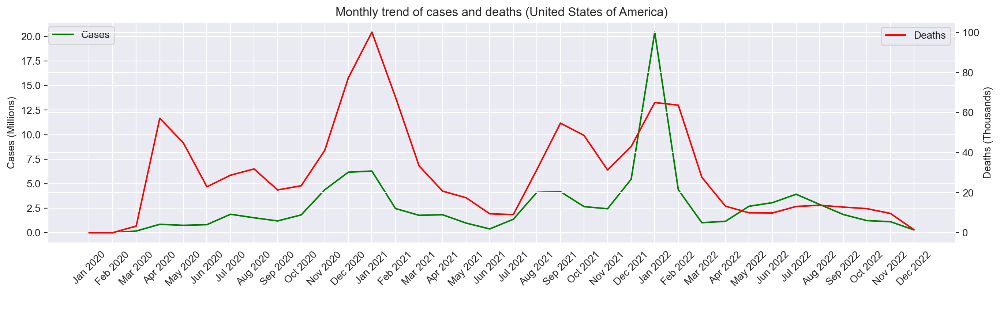

In [47]:
plot_countrywise("United States of America")

For India, the highest number of cases and deaths were recorded in the same month i.e., May 2021 with around 9 million cases and 120,000 deaths. There was also a period when there were around 6.5 million cases and death toll was close to 13,000. This trend is similar to that of USA around this period, this sudden rise in cases was due to the new variant of COVID which struck India in start of 2022.

| Month       | Cases       |Deaths      |
| ----------- | ----------- |----------- |
| May 2021    | 9.3 million |120,000     |
| Jan 2022    | 6.5 million |13,000      |



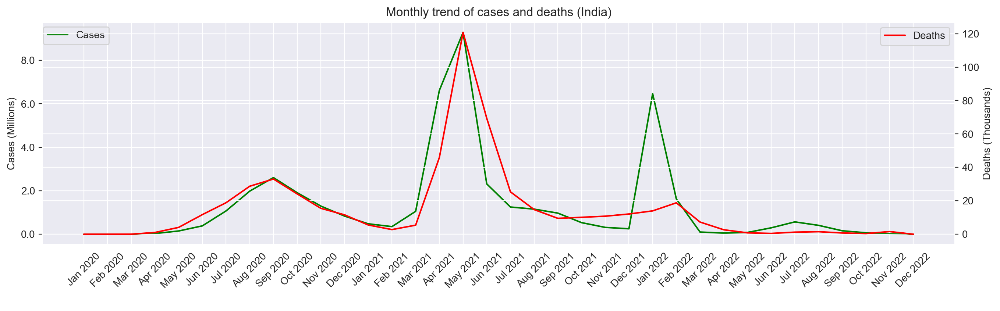

In [48]:
plot_countrywise("India")

For Brazil, the peak time was Apr 2021 and Feb 2022. Brazil recorded around 3 and 3.5 million cases in two consecutive months i.e., Jan 2022 and Feb 2022 but the death toll was in control and this pattern is seen in above two cases also.

| Month       | Cases       |Deaths      |
| ----------- | ----------- |----------- |
| Apr 2021    | 2 million   |84,000      |
| Feb 2022    | 3.5 million |22,000      |


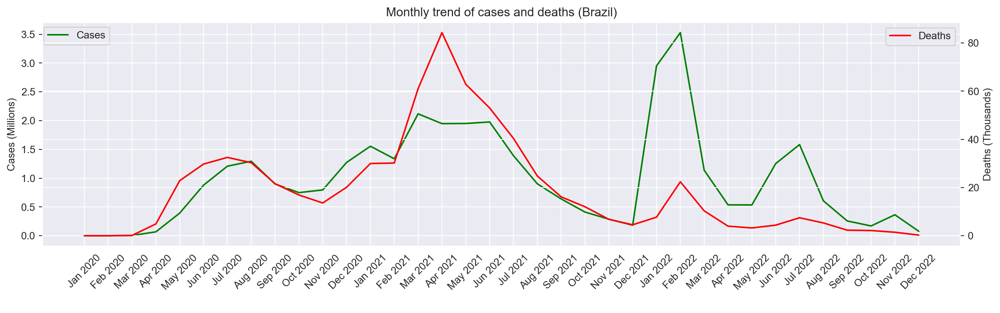

In [49]:
plot_countrywise("Brazil")

## Objective 2
### Explanation of Results

From the analysis we can observe that India is the country with the maximum number of people who are fully vaccinated. This very high difference from the other countries is due to the very high population in India, factoring in the population, Brazil is the country with the highest percentage of the population fully vaccinated at close to 79.18% as of November, followed by India at 68.89% and United States of America at 68.16%.


### Visualisation

The following graph shows total number of people fully vaccinated starting from Dec 2020 to Dec 2022 for the countries USA, India and Brazil. The vaccination rate for USA and Brazil remain more or less steady after the 4th quarter of 2021.

Also, it is clear that the United States started vaccinating its population well before Brazil and India started.

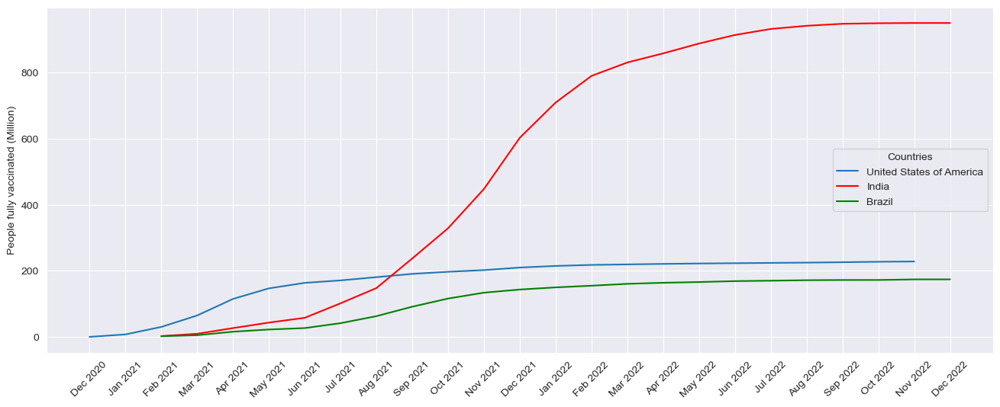

In [50]:
plot_vaccination_rate('United States of America','India','Brazil')

## Objective 3
### Explanation of Results

The top five countries that have vaccinated maximum percentage of their population are United Arab Emirates, Qatar, Puerto Rico, Chile and Cayman Islands, with UAE and Qatar fully vaccinating more than 98% of their population. On the other hand, it was observed that Chile administered the most vaccine doses per person among these countries. Most affected countries such as India, Brazil and United States of America were observed to have vaccinated 68.89%, 79.18% and 68.16% of their respective populations.

### Visualisation

The following two-bar barplot shows countries with the highest Fully Vaccinated Population percentage and the total vaccine doses administered per person by those countries. The barplot also shows comparision between countries with highest vaccinated population percentage and the most affected countries such as India, Brazil and United States of America.



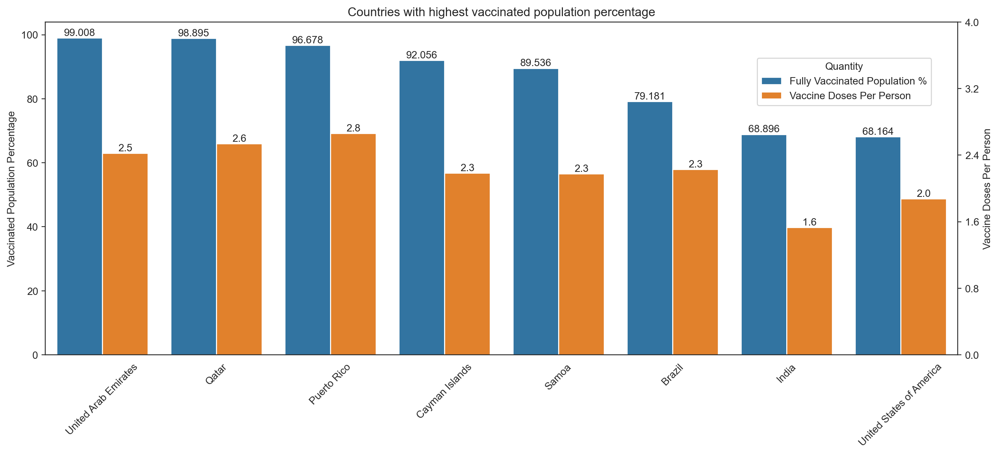

In [51]:
barplot_countries_highest_percentage(include_countries = top_three_countries)

It can be observed that countries like United States of America, India and Brazil have fully vaccinated less than 80% of their population, whereas the top 5 countries have vaccinated more than 90%.


The following choropleth world-map shows Vaccinated Population % of each country. This choropleth is useful in comparing countries and continents based on their vaccination success rates.

In [52]:
choropleth_vaccinated_percentage()

## Objective 4 a
### Explanation of Results

In this objective, we focused on vaccination adoption patterns across the world. 

### Visualisation

The following graph shows, pattern of countries for adopting the vaccination.
*   **92.3%** countries started vaccination in the time period from `Decmeber-2020` to `April-2021`. Some of the very few countries, who developed the vaccines. They started human trials in `July-2020`. That is the reason, we see there is only 1 country which started vaccination in that period.
*    We can see a sudden increase during `December-2020` because the human trials were over and countries started vaccinating their citizens.




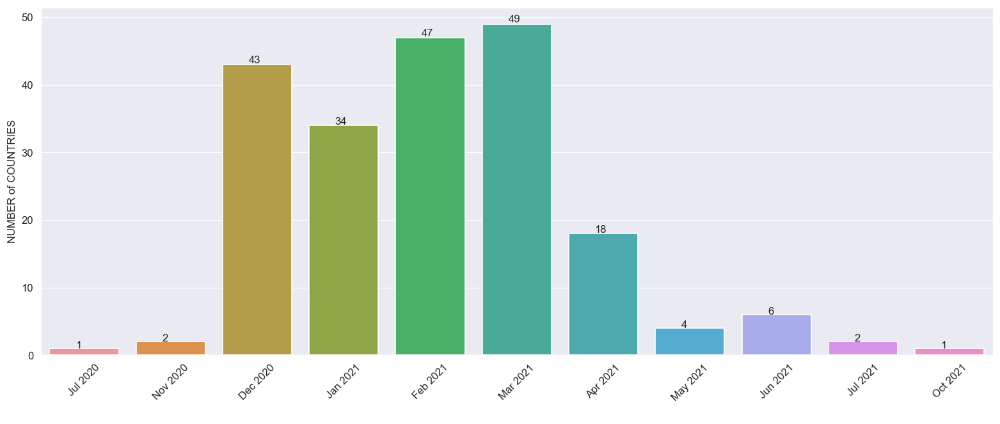

In [53]:
vaccine_adoption_graph()

## Objective 4 b
### Explanation of Results

From the analysis the most used vaccines are **Pfizer BioNTech – Comirnaty**, **AstraZeneca – Vaxzevria**, **Janssen - Ad26.COV 2-S** and **Moderna – Spikevax**. All of these vaccines are being used by more than 100 countries.

Pfizer BioNTech – Comirnaty the most popular vaccine, was developed by German biotechnology company BioNTech in collobration with the American company Pfizer. It showed an efficacy of 95% in trials conducted. 

### Visualisation

From this, it is clear that Pfizer BioNTech - Comirnaty is the most popular vaccine as it is being used by **164** countries i.e., over **70%** of the countries in the world are using it. The reason for this popularity, is the vaccine’s high efficacy, especially against the highly contagious Delta variant. Pfizer is an mRNA vaccine, and this has now become very popular as this technology has been validated by agencies like FDA and NHS. Moderna is also an mRNA vaccine but is not as widely used as Pfizer because of Moderna’s smaller production capacity when compared to Pfizer.

Plenty of demand still exists for other vaccines also. Many low to mid income countries are likely to rely on rivals, because the competitors can be stored easier and may be less expensive. There is also a production constraint as Pfizer cannot be producing for the whole world.

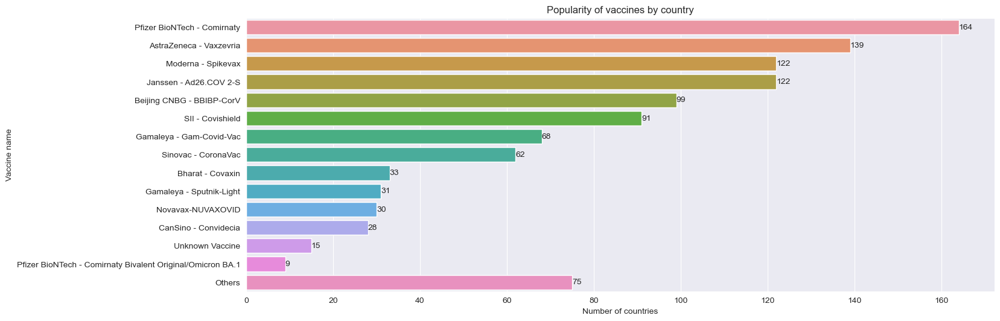

In [54]:
plot_vaccine_popularity(vaccines)

# Conclusion 

We saw the trend of the cases and deaths in the top three worst affected countries due to COVID. We saw similar patterns for these three countries, there are two major peaks - one around beginning of 2021 and the other in the beginning of 2022 with 2022 being less deadly. We can compare the Vaccinated Population % of the countries like **India, Brazil and United States of America** with the countries that have vaccinated highest percentage of their population. Countries like UAE and Qater have vaccinated more than **98%** of their population, whereas India has vaccinated **68.89%** and USA has vaccinated **68.16%**. We can aslo see from the choropleth world map the dramatic differences between the vaccination levels of countries in Africa and North America, South America and Europe. Among the vaccines used **Pfizer** is the most popular one as it is adopted by most number of countries.

After analysis, the result was that the maximum percentage of the countries started their vaccination program in December 2020. So over time, as we can see in the result of second objective that maximum number of the countries' population was fully vaccinated around Feb 2022, resulting in a tremendous decrease in new-cases-rate, as seen in the result of first objective.

The data used for analysis is taken from WHO datasets, which is subject to variations based on continuous verification and change.


In future, we would like to observe the patterns in the countries who recovered the fastest from COVID. We can also perform analysis on countries with the least Vaccinated Population percentage and compare it with the most affected countries.